# Big Data for Biologists: Decoding Genomic Function- Class 7

## How do you visualize similarities and differences of gene expression profiles across cell types? Part II

##  Learning Objectives
***Students should be able to***
 <ol>
 <li> Understand the k-means clustering algorithm 
 <li> Perform k-means clustering to identify patterns in gene expression data </li>
 <li> Make a scatter plot of the output from principal component analysis </li>
  

# Introduction to the K-means clustering algorithm

In [1]:
# magic! (don't worry about this)
%matplotlib inline
%load_ext autoreload
%autoreload 2
import matplotlib.pyplot as plt

import sys
sys.path.append('../helpers')
from kmeans_helpers import * 
from helpers import * 

In [2]:
#Step 1: Generate a dataset in 2 dimensions with 150 datapoints 
A,B=generate_random_data(150)

In [3]:
len(A)

150

In [4]:
len(B)

150

We plot the data:

In [5]:
plot(A,B)

We now decide that we would like 3 clusters, and it looks like all the data points fall in the range of [-5,5].

In [6]:
k=3
min_val=-5
max_val=5 

The first step in the algorithm is to randomly initialize the cluster centroids. 

In [7]:
x_centroids,y_centroids=initialize_centroids(k,min_val,max_val)

x-coordinates of centroids:[3.225964251636741, -0.00913447998820871, -0.09747186369609295]
y-coordinates of centroids:[-0.2368121037343709, 0.8311755015163937, -2.095947835540015]


Plot the cluster centroids that we initialized above:

In [8]:
plot(A,
     B,
     x_centroids=x_centroids,
     y_centroids=y_centroids)

We would like to find the closest centroid to each point. To do this, we will calculate the Euclidean distance from each point to each centroid. Euclidean distance can be found with the formula below: 
![euclidean distance formula](euclidean_distance.png)


In [9]:
#Calculate the distance of each point to each centroid. 
distances=[] 
for cluster_index in range(k): 
    distances.append(distance(A,B,x_centroids[cluster_index],y_centroids[cluster_index]))



In [10]:
#Assign each point to the cluster corresponding to the nearest centroid. 
num_points=len(A)
cluster_assignments=assign_cluster(distances,num_points)

In [11]:


print(cluster_assignments)

[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0]


In [12]:
#plot the data with cluster assignments --red indicates points in cluster 0, and blue indicates points in cluster 1. 
plot(A,
     B,
     x_centroids=x_centroids,
     y_centroids=y_centroids,
     cluster_assignments=cluster_assignments)

Now, we re-calculate the centroid positions so that the centroids are at the mid-point of each cluster. We use the helper function 'update_centroids' that is defined in helpers/kmeans_helpers.py

In [13]:
#call the function to update the centroids 
x_centroids,y_centroids=update_centroids(A,B,cluster_assignments,k)
print("updated x_centroids:"+str(x_centroids))
print("updated y_centroids:"+str(y_centroids))
plot(A,
    B,
    cluster_assignments=cluster_assignments,
    x_centroids=x_centroids,
    y_centroids=y_centroids)

updated x_centroids:[2.5163260746798373, -0.32194554745758391, 0]
updated y_centroids:[1.9713690131647936, 1.5831680823610652, 0]


In [14]:
# We repeat this cycle of assigning points to cluster and updating the cluster centroids. 
# At each iteration, you should observe an improved separation of the datapoints. 


#We combine the functions we have written above to produce a full iteration of the k-means clustering algorithm. 
def iterate(x,y,x_centroids,y_centroids,k): 
    num_points=len(x)
    
    #calculate centroid distances 
    distances=[] 
    for cluster_index in range(k): 
        distances.append(distance(x,y,x_centroids[cluster_index],y_centroids[cluster_index]))
        
    #Assign each point to the cluster corresponding to the nearest centroid. 
    cluster_assignments=assign_cluster(distances,num_points)

    #update the centroid assignments 
    x_centroids,y_centroids=update_centroids(x,y,cluster_assignments,k)
    
    #generate a plot 
    plot(x,
        y,
        x_centroids=x_centroids,
        y_centroids=y_centroids,
        cluster_assignments=cluster_assignments)
    
    #return the new cluster assignments and centroid values 
    return cluster_assignments,x_centroids,y_centroids

In [15]:
#run an iteration of the algorithm 
#run this code block several times to observe progress improvements in cluster assignments 
cluster_assignments,x_centroids,y_centroids=iterate(A,B,x_centroids,y_centroids,k)

In [16]:
#Finally, we define the end-criteria -- the algorithm is complete when the cluster assignments are no longer changing. 
def check_finished(old_cluster_assignments,new_cluster_assignments): 
    for i in range(len(old_cluster_assignments)): 
        if old_cluster_assignments[i]!=new_cluster_assignments[i]: 
            return False 
    return True 

In [17]:
#We put all the steps above together to define the full k-means clustering algorithm 
def k_means(x,y,k): 
    min_val=min(x+y)
    max_val=max(x+y)
    x_centroids,y_centroids=initialize_centroids(k,min_val,max_val)
    cluster_assignments,x_centroids,y_centroids=iterate(x,y,x_centroids,y_centroids,k)
    finished=False 
    while (finished==False): 
        new_assignments,x_centroids,y_centroids=iterate(x,y,x_centroids,y_centroids,k)
        finished=check_finished(cluster_assignments,new_assignments)
        cluster_assignments=new_assignments
    return cluster_assignments

In [18]:
#Let's run the full algorithm on our toy dataset 
cluster_assignments=k_means(A,B,k)

x-coordinates of centroids:[-0.29087120495650343, -0.32911171541968143, -1.8610853032941297]
y-coordinates of centroids:[-1.9360820493365725, -2.4443081823320805, 1.4187748113348713]


What would happen if you chose a different value of k (number of clusters)? 


In [19]:
#TODO:use the k_means function defined above to run k-means clustering 
#on A,B for k=2 and k=4. 

#Which value of k (2,3, or 4) gives the best separation of the datapoints into cohesive clusters? 

# Using K-means clustering to examine differential gene expression. 

We will now examine differential gene expression analysis across 4 organ systems. We pick the following seven systems to include in the analysis: 

* Blood 
* Embryonic
* Immune 
* Respiratory 

In the example above, we wrote the k-means clustering code "from scratch". However, python already has a KMeans clustering function in the scikit learn library, which is more efficient for clustering large datasets than the function that we wrote above. We will use the built-in KMeans function in our further data analysis. 

In [20]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score,silhouette_samples


In [21]:
#use the help command to learn more about the KMeans clustering function. 
#Uncomment the following line of code to run the "help" function 
#help(KMeans)

In [22]:
import pandas as pd 
systems_subset=["Blood","Embryonic","Immune","Respiratory"]
data,batches=load_rnaseq_data(systems_subset=systems_subset)
data=data.transpose()

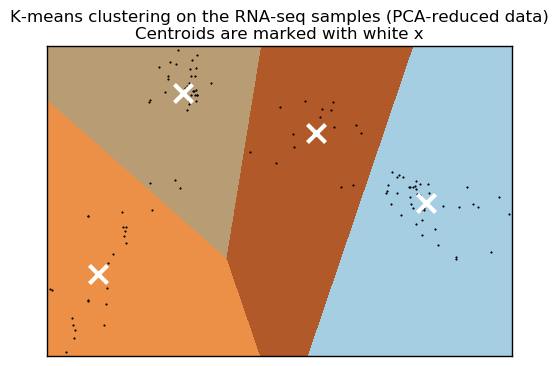

('For n_clusters =', 4, 'The average silhouette_score is :', 0.66727282139583322)


In [23]:
k=4
clusters=scikit_kmeans(data,k)

We would like a way to determine how well the k-means clustering has separated the data. One way to assess the performance of the clustering algorithm is to compare inter-cluster distance to intra-cluster distance. We would like points in the same cluster to be near each other, and points that are in different clusters to be far apart: 
![Inter-cluster and intra-cluster distance](inter_cluster_vs_intra_cluster.png)

# Silhouette analysis 


**Silhouette analysis** allows us to compute the ratio of inter-cluster distance to intra-cluster distance for each cluster. The silhouette plot displays a measure of how close each point in one cluster is to points in the neighboring clusters and thus provides a way to assess parameters like number of clusters visually. This measure has a range of [-1, 1].

Silhouette coefficients  near +1 indicate that the sample is far away from the neighboring clusters. A value of 0 indicates that the sample is on or very close to the decision boundary between two neighboring clusters and negative values indicate that those samples might have been assigned to the wrong cluster. 

By calculating the average silhuoette score across all samples, which will also fall in the range [-1,1], we can assess how well separated the data is. 

We have written a wrapper called ** scikit_silhouette** around the scikit learn silhouette graphing function. Run this function on our data to determine how well the clustering separates samples into similar groups:

('For n_clusters =', 4, 'The average silhouette_score is :', 0.66727282139583322)


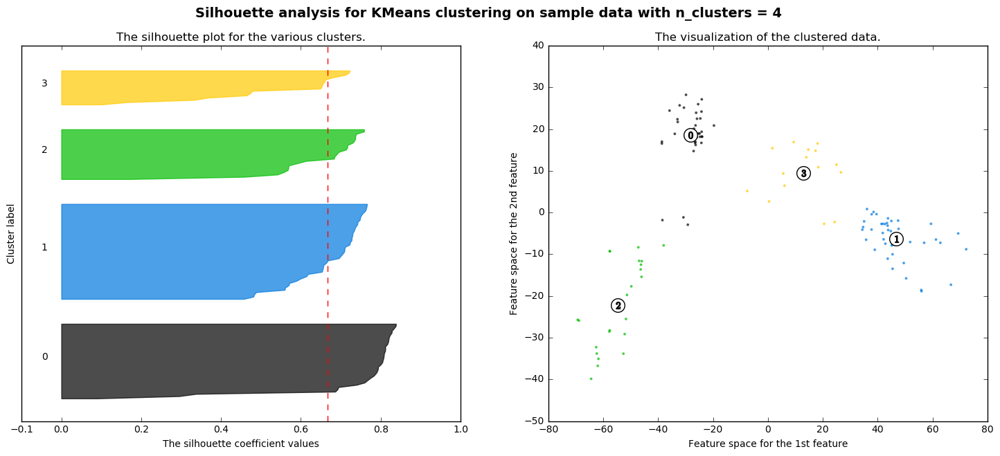

In [24]:
scikit_silhouette(data,k)

What happens as we vary the number of clusteres from k=2 to k=10? 

('For n_clusters =', 2, 'The average silhouette_score is :', 0.65586092887211511)


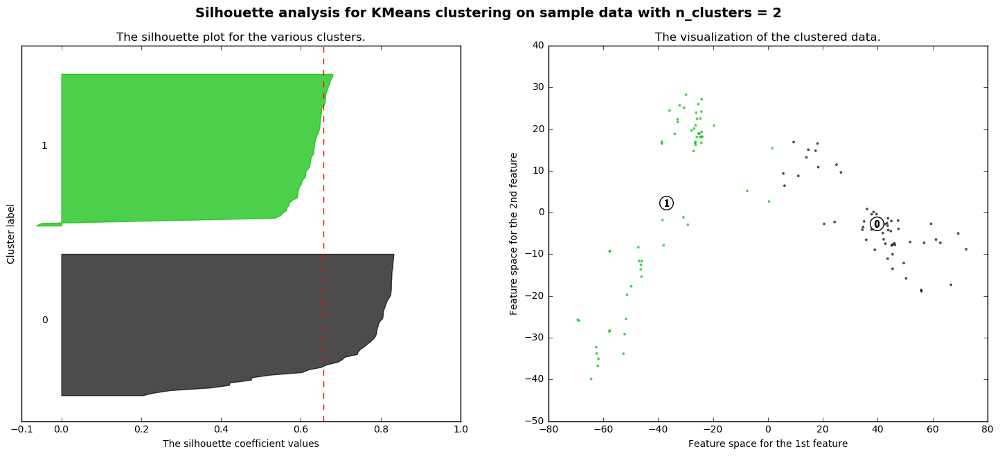

('For n_clusters =', 3, 'The average silhouette_score is :', 0.6685635740811704)


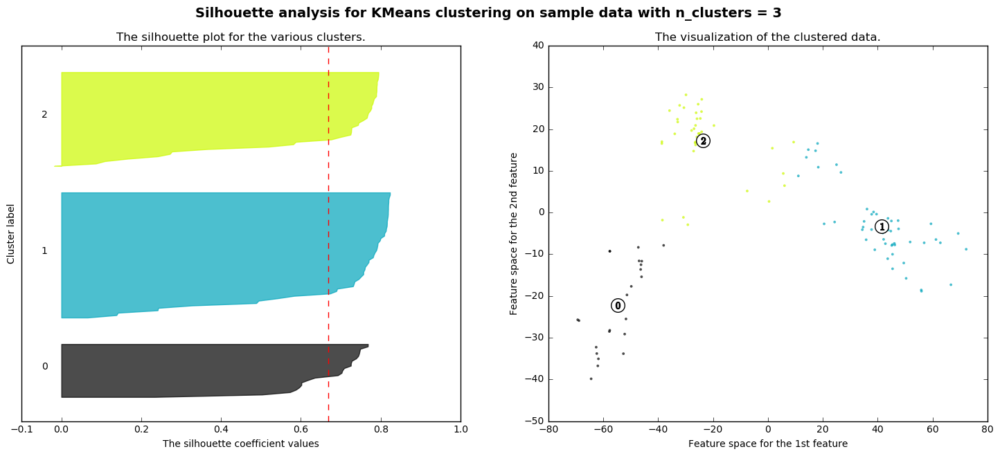

('For n_clusters =', 4, 'The average silhouette_score is :', 0.66727282139583322)


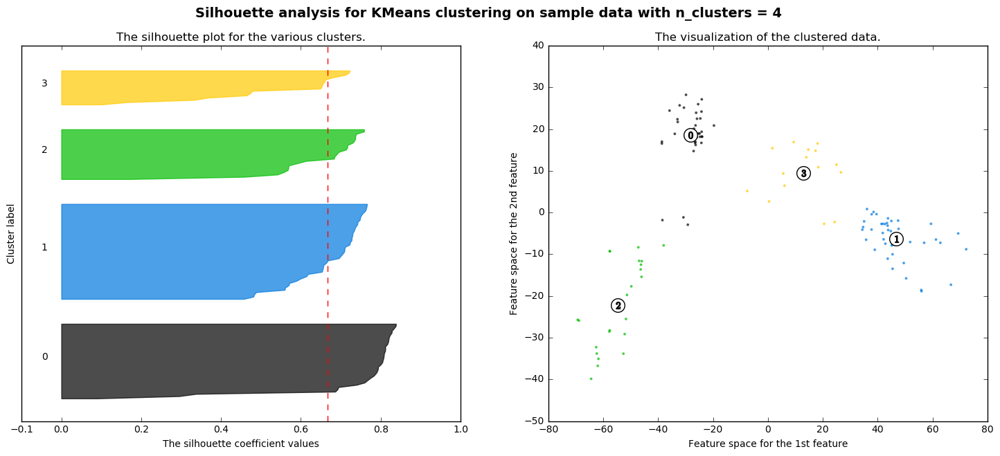

('For n_clusters =', 5, 'The average silhouette_score is :', 0.65417935907833147)


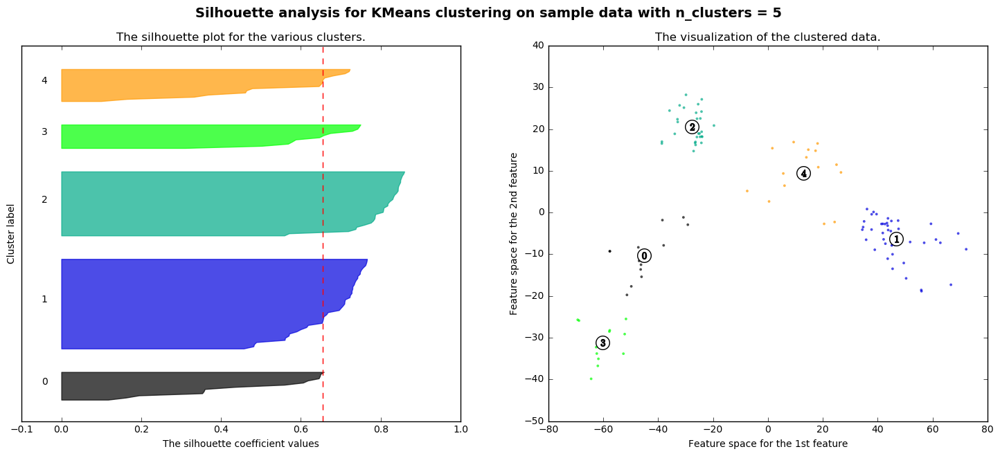

('For n_clusters =', 6, 'The average silhouette_score is :', 0.60658547567569221)


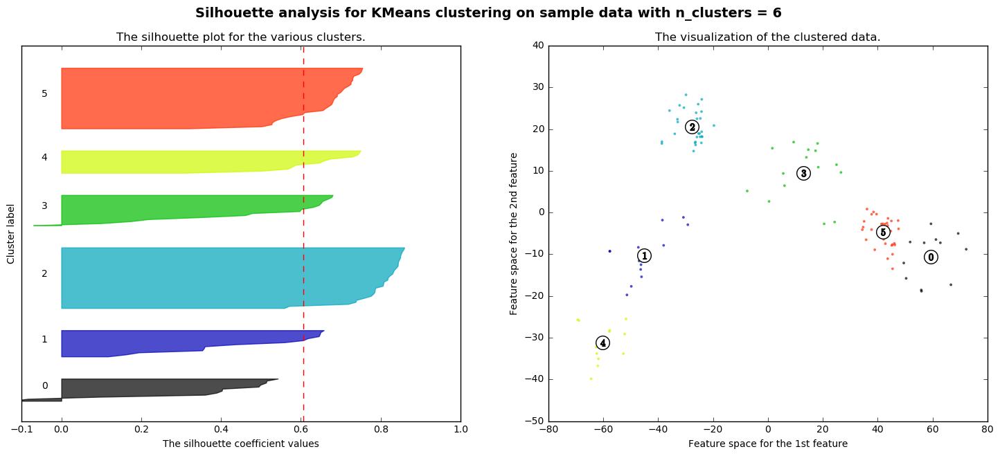

In [25]:
for k in range(2,7): 
    scikit_silhouette(data,k)

We can plot the average silhouette score for different values of k and pick the value of k that gives the highest average silhouette. 

In [26]:
k=[2,3,4,5,6]
scores=[0.66,0.67,0.67,0.65,0.61] 



In [27]:
import plotly 
plotly.offline.init_notebook_mode()
import plotly.graph_objs as go  
b=[go.Bar(x=k,y=scores,name="Silhuoette Scores for varied k")]
fig=go.Figure(data=b,layout=go.Layout(barmode="group"))
plotly.offline.iplot(fig)

It appears that the data is best separated by 3 or 4 clusters. 

# Visualizing gene expression data in a heatmap

We can visualize the 116 clustered samples in a heatmap, with samples along the y-axis and genes along the x-axis. We use the SpectralBiclustering library from scikit learng to group rows and columns that are most similar to each other in the data matrix. Note how we can see four distinct clusters  in the data. 

In [28]:
from sklearn.cluster.bicluster import SpectralBiclustering


In [30]:
n_clusters=4
model = SpectralBiclustering(n_clusters=n_clusters, method='log',
                             random_state=0)
model.fit(data)
order_rows=list(np.argsort(model.row_labels_))
order_cols=list(np.argsort(model.column_labels_))
data=np.asarray(data)
data=data[order_rows,:]
data=data[:,order_cols]


In [31]:
trace =[Heatmap(z=data)]

layout = go.Layout(
    title='Gene Expression Across Organ Systems',
    xaxis=dict(
        title='Gene',
        titlefont=dict(
            family='Courier New, monospace',
            size=18,
            color='#7f7f7f'
        )
    ),
    yaxis=dict(
        title='Sample',
        titlefont=dict(
            family='Courier New, monospace',
            size=18,
            color='#7f7f7f'
        )
    )
)
fig=go.Figure(data=trace,layout=layout)
plotly.offline.iplot(fig)